Introduction
I obtained this dataset from Kaggle and the purpose of this project is to perform Exploraory data analysis (EDA), data cleaning and pre-processing on the dataset in preparation for model building.

In [3]:
# importing required libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
# importing dataset
df = pd.read_csv('LifeExpectancy.csv')

# displaying the dataset in pandas dataframe
df

,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2923,Zimbabwe,2004,Developing,44.3,723,27,4.36,0.000000,68.0,31,...,67.0,7.13,65.0,33.6,454.366654,12777511.0,9.4,9.4,0.407,9.2
2924,Zimbabwe,2003,Developing,44.5,715,26,4.06,0.000000,7.0,998,...,7.0,6.52,68.0,36.7,453.351155,12633897.0,9.8,9.9,0.418,9.5
2925,Zimbabwe,2002,Developing,44.8,73,25,4.43,0.000000,73.0,304,...,73.0,6.53,71.0,39.8,57.348340,125525.0,1.2,1.3,0.427,10.0
2926,Zimbabwe,2001,Developing,45.3,686,25,1.72,0.000000,76.0,529,...,76.0,6.16,75.0,42.1,548.587312,12366165.0,1.6,1.7,0.427,9.8


### Exploring the dataset for general knowledge

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2928 entries, 0 to 2927
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2928 non-null   object 
 1   Year                             2928 non-null   int64  
 2   Status                           2928 non-null   object 
 3   Life expectancy                  2928 non-null   float64
 4   Adult Mortality                  2928 non-null   int64  
 5   infant deaths                    2928 non-null   int64  
 6   Alcohol                          2735 non-null   float64
 7   percentage expenditure           2928 non-null   float64
 8   Hepatitis B                      2375 non-null   float64
 9   Measles                          2928 non-null   int64  
 10   BMI                             2896 non-null   float64
 11  under-five deaths                2928 non-null   int64  
 12  Polio               

In [6]:
# making a list of the column names
df.columns

Index(['Country', 'Year', 'Status', 'Life expectancy', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles ', ' BMI ', 'under-five deaths ', 'Polio', 'Total expenditure',
       'Diphtheria ', ' HIV/AIDS', 'GDP', 'Population',
       ' thinness  1-19 years', ' thinness 5-9 years',
       'Income composition of resources', 'Schooling'],
      dtype='object')

In [7]:
#checking the number of rows and columns in the dataset
df.shape

(2928, 22)

In [8]:
#checking the dat types for each column
df.dtypes

,0
Country,object
Year,int64
Status,object
Life expectancy,float64
Adult Mortality,int64
infant deaths,int64
Alcohol,float64
percentage expenditure,float64
Hepatitis B,float64
Measles,int64


In [9]:
#checking the summary statistics of the numerical columns
df.describe()

,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
count,2928.00000,2928.000000,2928.000000,2928.000000,2735.000000,2928.000000,2375.000000,2928.000000,2896.000000,2928.000000,2909.000000,2702.000000,2909.000000,2928.000000,2485.000000,2.284000e+03,2896.000000,2896.000000,2768.000000,2768.000000
mean,2007.50000,69.224932,164.796448,30.407445,4.614856,740.321185,80.960842,2427.855874,38.235394,42.179303,82.548298,5.930163,82.321416,1.747712,7494.210719,1.276454e+07,4.850622,4.881423,0.627419,11.999639
std,4.61056,9.523867,124.292079,118.114450,4.050749,1990.930605,25.018337,11485.970937,19.959590,160.700547,23.416674,2.483273,23.706644,5.085542,14282.251492,6.103765e+07,4.420829,4.509609,0.210978,3.346440
min,2000.00000,36.300000,1.000000,0.000000,0.010000,0.000000,1.000000,0.000000,1.000000,0.000000,3.000000,0.370000,2.000000,0.100000,1.681350,3.400000e+01,0.100000,0.100000,0.000000,0.000000
25%,2003.75000,63.100000,74.000000,0.000000,0.905000,4.853964,77.000000,0.000000,19.300000,0.000000,78.000000,4.260000,78.000000,0.100000,463.852618,1.966738e+05,1.600000,1.575000,0.493000,10.100000
50%,2007.50000,72.100000,144.000000,3.000000,3.770000,65.611455,92.000000,17.000000,43.350000,4.000000,93.000000,5.750000,93.000000,0.100000,1764.973870,1.391756e+06,3.300000,3.400000,0.677000,12.300000
75%,2011.25000,75.700000,228.000000,22.000000,7.715000,442.614322,97.000000,362.250000,56.100000,28.000000,97.000000,7.490000,97.000000,0.800000,5932.899677,7.426746e+06,7.200000,7.200000,0.779250,14.300000
max,2015.00000,89.000000,723.000000,1800.000000,17.870000,19479.911610,99.000000,212183.000000,77.600000,2500.000000,99.000000,17.600000,99.000000,50.600000,119172.741800,1.293859e+09,27.700000,28.600000,0.948000,20.700000


In [10]:
# creating correlation matrix for the numerical columns
corr_matrix = df.corr(numeric_only=True)

# displaying the correlation matrix
corr_matrix

,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
Year,1.000000,0.170033,-0.079052,-0.036464,-0.049175,0.032723,0.105898,-0.081840,0.104668,-0.041980,0.094498,0.087309,0.134817,-0.138789,0.102707,0.017199,-0.045082,-0.048152,0.242953,0.213265
Life expectancy,0.170033,1.000000,-0.696359,-0.196557,0.404877,0.381864,0.256762,-0.157586,0.567694,-0.222529,0.465556,0.218086,0.479495,-0.556556,0.461455,-0.021538,-0.477183,-0.471584,0.724776,0.751975
Adult Mortality,-0.079052,-0.696359,1.000000,0.078756,-0.195848,-0.242860,-0.162476,0.031176,-0.387017,0.094146,-0.274823,-0.115281,-0.275131,0.523821,-0.296049,-0.013647,0.302904,0.308457,-0.457626,-0.454612
infant deaths,-0.036464,-0.196557,0.078756,1.000000,-0.116647,-0.085906,-0.224750,0.501038,-0.227480,0.996628,-0.171063,-0.128826,-0.175539,0.024955,-0.108643,0.556781,0.465700,0.471340,-0.145018,-0.195202
Alcohol,-0.049175,0.404877,-0.195848,-0.116647,1.000000,0.341112,0.086217,-0.052569,0.338253,-0.113388,0.222057,0.302902,0.222378,-0.049918,0.354406,-0.035376,-0.432302,-0.420862,0.450254,0.548001
percentage expenditure,0.032723,0.381864,-0.242860,-0.085906,0.341112,1.000000,0.016704,-0.056831,0.231130,-0.088152,0.147664,0.176245,0.144022,-0.098230,0.899370,-0.025716,-0.252397,-0.253931,0.382244,0.391466
Hepatitis B,0.105898,0.256762,-0.162476,-0.224750,0.086217,0.016704,1.000000,-0.121211,0.155174,-0.234353,0.483989,0.070983,0.610199,-0.113395,0.083918,-0.123834,-0.122479,-0.127039,0.199141,0.222895
Measles,-0.081840,-0.157586,0.031176,0.501038,-0.052569,-0.056831,-0.121211,1.000000,-0.176069,0.507718,-0.136460,-0.106405,-0.142174,0.030673,-0.076646,0.265936,0.224579,0.220836,-0.129465,-0.138344
BMI,0.104668,0.567694,-0.387017,-0.227480,0.338253,0.231130,0.155174,-0.176069,1.000000,-0.237910,0.287579,0.238765,0.286077,-0.243735,0.304442,-0.072051,-0.530805,-0.537784,0.509299,0.558363
under-five deaths,-0.041980,-0.222529,0.094146,0.996628,-0.113388,-0.088152,-0.234353,0.507718,-0.237910,1.000000,-0.189137,-0.130355,-0.196083,0.037783,-0.112302,0.544401,0.467771,0.472244,-0.163185,-0.210945


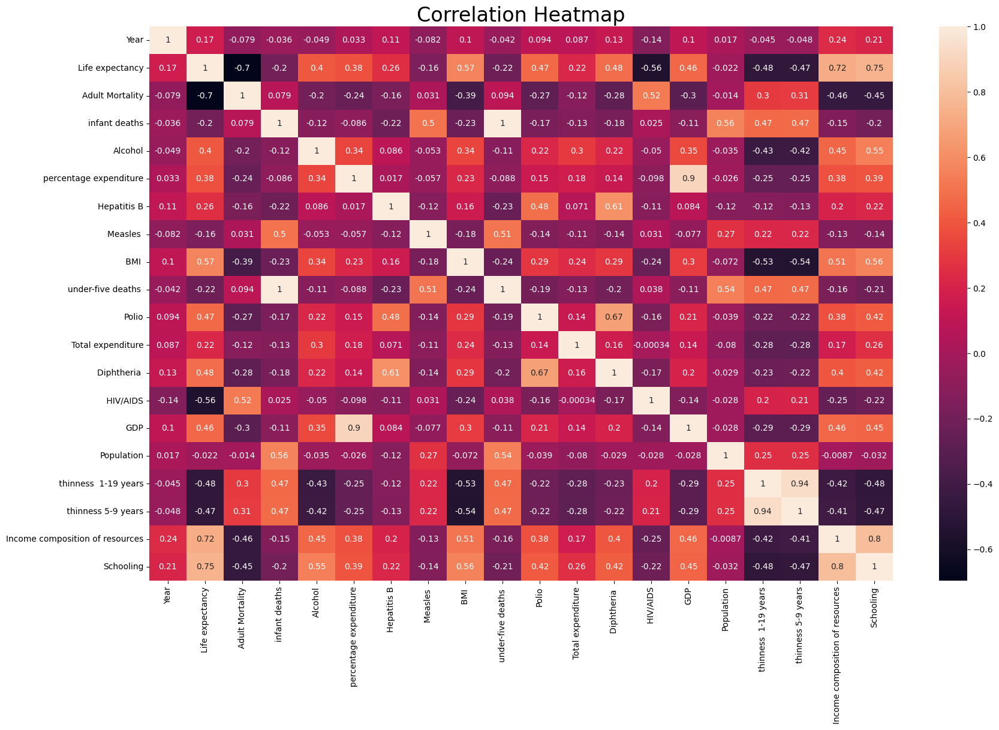

In [11]:
# Creating a heatmap using Seaborn
plt.figure(figsize=(20, 12))
sns.heatmap(corr_matrix, annot=True)
plt.title('Correlation Heatmap', size = 24)

# displaying map
plt.show()

In [12]:
# checking for the number of unique entries for each feature
df.nunique()

,0
Country,183
Year,16
Status,2
Life expectancy,362
Adult Mortality,425
infant deaths,209
Alcohol,1076
percentage expenditure,2323
Hepatitis B,87
Measles,958


### Profiling the dataset to get summary staistics and charts

In [13]:
#installing ydat profiling
!pip install ydata-profiling

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 356.2/356.2 kB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 19.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 28.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 64.6 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=7cc03102eb02af3f0a458f834f00e7510830b6c56fd98fd42f4eaca9fbcb7704
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [14]:
# importing profilereport
from ydata_profiling import ProfileReport

In [15]:
# generating summary statistics and charts to give an overview of the dataset
profile = ProfileReport(df, title="Pandas Profiling Report", explorative=True)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Data Visualization: Histograms

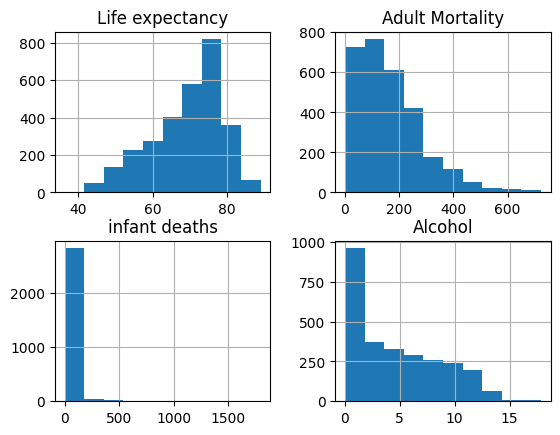

In [72]:
# generating histogram to show if distribution is normal or skewed
df[['Life expectancy', 'Adult Mortality', 'infant deaths', 'Alcohol']].hist()

# displaying the plot
plt.show()

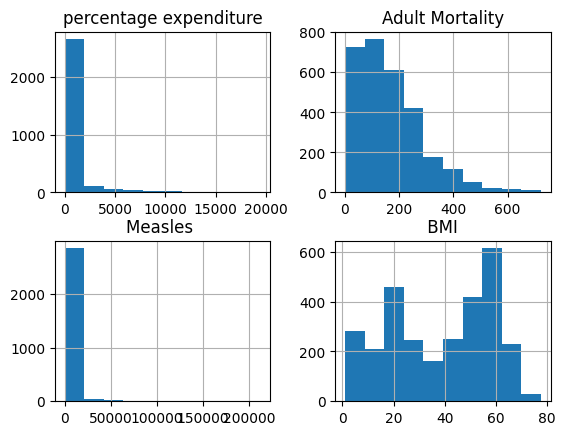

In [73]:
# generating histogram to show if distribution is normal or skewed
df[['percentage expenditure', 'Adult Mortality', 'Measles ', ' BMI ']].hist()

# displaying the plot
plt.show()

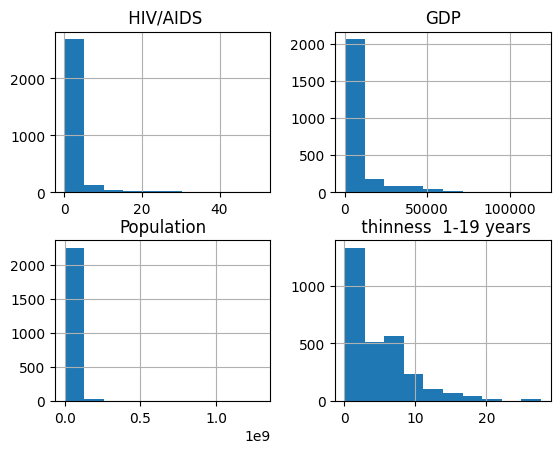

In [74]:
# generating histogram to show if distribution is normal or skewed
df[[' HIV/AIDS', 'GDP', 'Population', ' thinness  1-19 years']].hist()

# displaying the plot
plt.show()

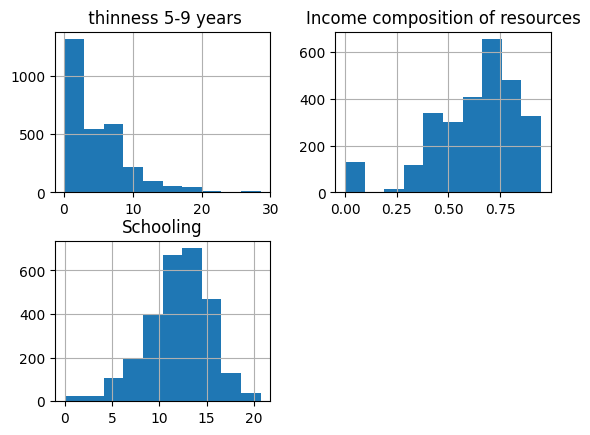

In [75]:
# generating histogram to show if distribution is normal or skewed
df[[' thinness 5-9 years', 'Income composition of resources', 'Schooling']].hist()

# displaying the plot
plt.show()

From the histograms, Income composition of resources and schooling show an approximate normal distribution, so I will use z-score to remove the outliers during the data cleaning process. All other columns are skewed, so I will use IQR method to remove their outliers

### Step 2: Data Cleaning

#### (i)Removing duplicates

In [16]:
# checking for duplicates
df.duplicated().sum()

0

Result: There are no duplicate entries in this dataset

#### (ii) Filling null values
EDA reveals that there are 2513 missing cells from the underlsted feature columns:

'Alcohol'

'Hapatitis B'

'BMI'

'Polio'

'Total expenditure'

'Diphtheria'

'GDP'

'Population'

'thinness  1-19 years'

'thinness 5-9 years'

'Income composition of resources'

'Schooling'




In [17]:
# enabling copy on write to avoid creating unnecessary copies
pd.options.mode.copy_on_write = True

In [18]:
#making a copy of the dataframe
df_no_null = df.copy()

# displaying the general inforamtion of the copied dataframe
df_no_null.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2928 entries, 0 to 2927
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2928 non-null   object 
 1   Year                             2928 non-null   int64  
 2   Status                           2928 non-null   object 
 3   Life expectancy                  2928 non-null   float64
 4   Adult Mortality                  2928 non-null   int64  
 5   infant deaths                    2928 non-null   int64  
 6   Alcohol                          2735 non-null   float64
 7   percentage expenditure           2928 non-null   float64
 8   Hepatitis B                      2375 non-null   float64
 9   Measles                          2928 non-null   int64  
 10   BMI                             2896 non-null   float64
 11  under-five deaths                2928 non-null   int64  
 12  Polio               

In [63]:
df_no_null['Alcohol'] = df_no_null['Alcohol'].fillna(df_no_null['Alcohol'].median())
df_no_null['Hepatitis B'] = df_no_null['Hepatitis B'].fillna(value = df_no_null['Hepatitis B'].median())
df_no_null[' BMI '] = df_no_null[' BMI '].fillna(value = df_no_null[' BMI '].median())
df_no_null['Polio'] = df_no_null['Polio'].fillna(value = df_no_null['Polio'].median())
df_no_null['Total expenditure'] = df_no_null['Total expenditure'].fillna(value = df_no_null['Total expenditure'].median())
df_no_null['Polio'] = df_no_null['Polio'].fillna(value = df_no_null['Polio'].median())
df_no_null['Total expenditure'] = df_no_null['Total expenditure'].fillna(value = df_no_null['Total expenditure'].median())
df_no_null['Diphtheria '] = df_no_null['Diphtheria '].fillna(value = df_no_null['Diphtheria '].median())
df_no_null['GDP'] = df_no_null['GDP'].fillna(value = df_no_null['GDP'].median())
df_no_null['Population'] = df_no_null['Population'].fillna(value = df_no_null['Population'].median())
df_no_null[' thinness  1-19 years'] = df_no_null[' thinness  1-19 years'].fillna(value = df_no_null[' thinness  1-19 years'].median())
df_no_null[' thinness 5-9 years'] = df_no_null[' thinness 5-9 years'].fillna(value = df_no_null[' thinness 5-9 years'].median())
df_no_null['Income composition of resources'] = df_no_null['Income composition of resources'].fillna(value = df_no_null['Income composition of resources'].median())
df_no_null['Schooling'] = df_no_null['Schooling'].fillna(value = df_no_null['Schooling'].median())

In [64]:
# confirming the null values has been replaced
df_no_null.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2928 entries, 0 to 2927
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2928 non-null   object 
 1   Year                             2928 non-null   int64  
 2   Status                           2928 non-null   object 
 3   Life expectancy                  2928 non-null   float64
 4   Adult Mortality                  2928 non-null   int64  
 5   infant deaths                    2928 non-null   int64  
 6   Alcohol                          2928 non-null   float64
 7   percentage expenditure           2928 non-null   float64
 8   Hepatitis B                      2928 non-null   float64
 9   Measles                          2928 non-null   int64  
 10   BMI                             2928 non-null   float64
 11  under-five deaths                2928 non-null   int64  
 12  Polio               

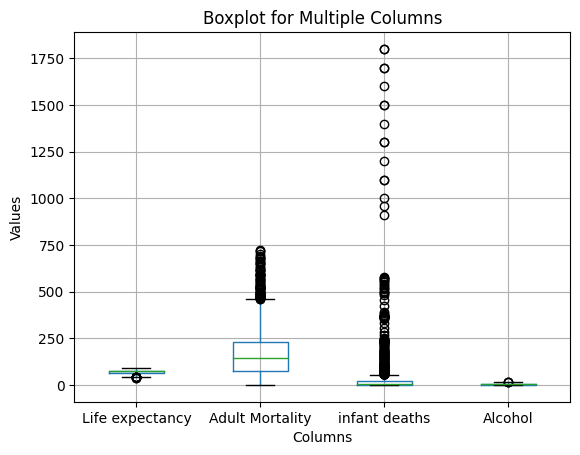

In [28]:
# generating boxplot to show outliers
df_no_null[['Life expectancy', 'Adult Mortality', 'infant deaths', 'Alcohol']].boxplot()

# displaying the plot
plt.title("Boxplot for 4 Columns")
plt.xlabel("Column names")
plt.ylabel("Values")
plt.show()

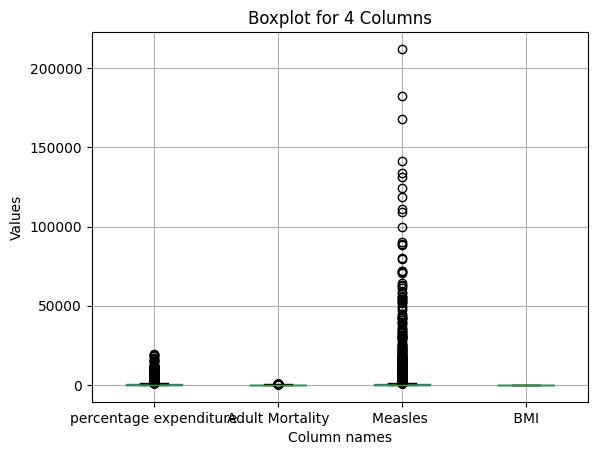

In [34]:
# generating boxplot to show outliers
df_no_null[['percentage expenditure', 'Adult Mortality', 'Measles ', ' BMI ']].boxplot()

# displaying the plot
plt.title("Boxplot for 4 Columns")
plt.xlabel("Column names")
plt.ylabel("Values")
plt.show()

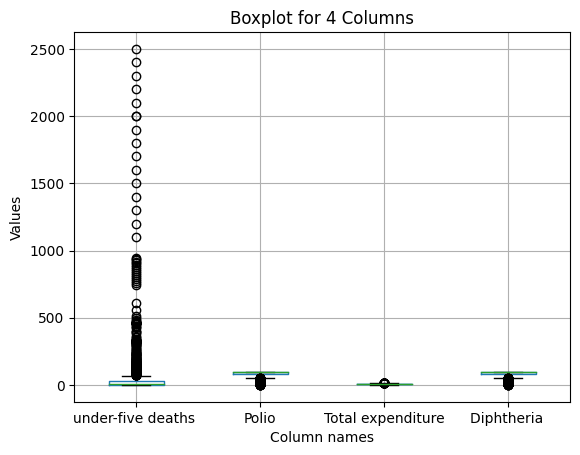

In [50]:
# generating boxplot to show outliers
df_no_null[['under-five deaths ', 'Polio', 'Total expenditure', 'Diphtheria ']].boxplot()

# displaying the plot
plt.title("Boxplot for 4 Columns")
plt.xlabel("Column names")
plt.ylabel("Values")
plt.show()

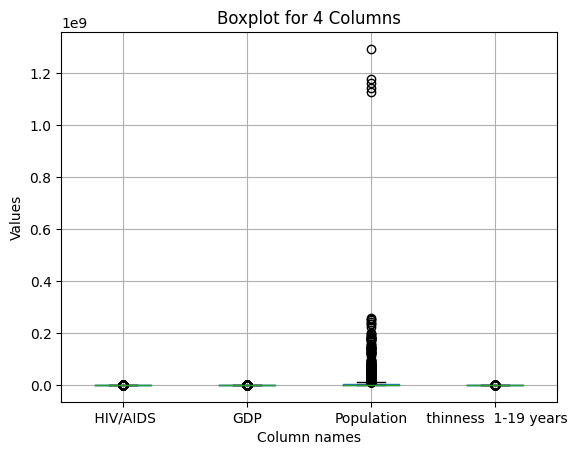

In [58]:
# generating boxplot to show outliers
df_no_null[[' HIV/AIDS', 'GDP', 'Population', ' thinness  1-19 years']].boxplot()

# displaying the plot
plt.title("Boxplot for 4 Columns")
plt.xlabel("Column names")
plt.ylabel("Values")
plt.show()

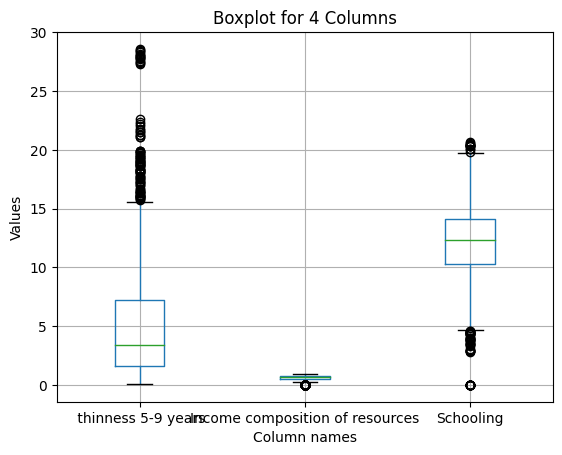

In [62]:
# generating boxplot to show outliers
df_no_null[[' thinness 5-9 years', 'Income composition of resources', 'Schooling']].boxplot()

# displaying the plot
plt.title("Boxplot for 4 Columns")
plt.xlabel("Column names")
plt.ylabel("Values")
plt.show()

**The boxplot shows that there are outliers in all columns except Adult mortality, BMI, Total expenditure, HIV/AIDS, GDP, thinness 1-19 years. Since the columns with outliers shows a skewed distribution, Comparing these columns with outliers with their distribution, I will use z-score to clean those with normal distribution and IQR co clean those with skewed distribution.**

In [80]:
# Calculate Q1 (25th percentile) and Q3 (75th percentile)
Q1 = df_no_null['Schooling'].quantile(0.25)
Q3 = df_no_null['Schooling'].quantile(0.75)

# Calculate IQR
IQR = Q3 - Q1

# Define the bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Remove outliers
df_no_outliers = df_no_null[(df_no_null['Schooling'] >= lower_bound) & (df_no_null['Schooling'] <= upper_bound)]

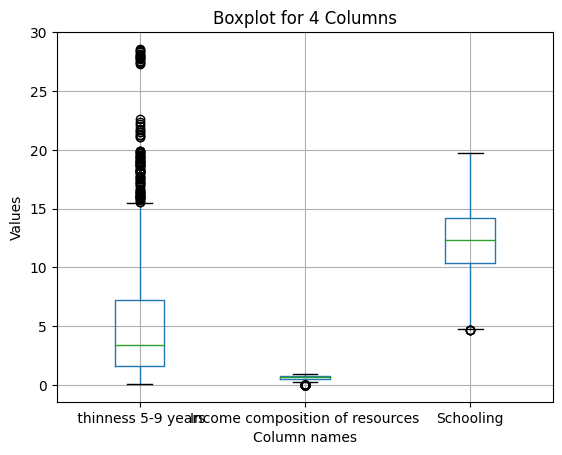

In [82]:
# generating boxplot to show outliers
df_no_outliers[[' thinness 5-9 years', 'Income composition of resources', 'Schooling']].boxplot()

# displaying the plot
plt.title("Boxplot for 4 Columns")
plt.xlabel("Column names")
plt.ylabel("Values")
plt.show()